
# <center><b>Food Aggregator and Delivery Analysis<b></center>

---
# **Table of Contents**
---

**1.** [**Introduction**](#Section1)<br>
**2.** [**Problem Statement**](#Section2)<br>
**3.** [**Installing & Importing Libraries**](#Section3)<br>
  - **3.1** [**Installing Libraries**](#Section31)
  - **3.2** [**Upgrading Libraries**](#Section32)
  - **3.3** [**Importing Libraries**](#Section33)

**4.** [**Data Acquisition & Description**](#Section4)<br>
  - **4.1** [**Data Description**](#Section41)
  - **4.2** [**Data Information**](#Section42)

**5.** [**Data Pre-profiling**](#Section5)<br>
**6.** [**Data Cleaning**](#Section6)<br>
**7.** [**Data Post-profiling**](#Section7)<br>
**8.** [**Exploratory Data Analysis**](#Section8)<br>
**9.** [**Summarization**](#Section9)<br>

---
<a name = Section1></a>
# **1. Introduction**
---


- Foodazing, an India based food aggregator and online booking & delivery company has established a lot of presence across the globe.

<center><img src="https://cdn2.iconfinder.com/data/icons/valentine-day-16/512/599_dinner_food_BBQ_love_valentine_valentine_valentines_day_love-512.png" width=50%></center>

- On their 10 year anniversary, they want to release an analysis to the public about their global presence and wants to thank their collaborators.

---
<a name = Section2></a>
# **2. Problem Statement**
---

- Your **data analysis team** has been tasked with analysing the data and generate **valuable insights**.

- The analysis should include **Foodazing's presence** in both - **India** and **Rest of the world**.

<center><img src="https://www.chefspencil.com/wp-content/uploads/free-food-clipart-19-960x642.jpg" width=50%></center>

- They have provided you with a dataset that consists information about various **restaurant collaborators** in and out of India.

- The many factors include, **country code**, **average cost of two people** in a restaurant, **city**, **locality**, **currency**, and some **rating based features**.

---
<a name = Section3></a>
# **3. Installing & Importing Libraries**
---

<a name = Section31></a>
### **3.1 Installing Libraries**

In [2]:
!pip install -q datascience                                        
!pip install -q pandas-profiling                                   

In [ ]:
!pip install wordcloud

<a name = Section32></a>
### **3.2 Upgrading Libraries**

- **After upgrading** the libraries, you need to **restart the runtime** to make the libraries in sync. 

- Make sure not to execute the cell above (3.1) and below (3.2) again after restarting the runtime.

In [4]:
!pip install -q --upgrade datascience                               
!pip install -q --upgrade pandas-profiling                         
!pip install --upgrade -q plotly
!pip install -q pyyaml==5.4.1

<a name = Section33></a>
### **3.3 Importing Libraries**

In [1]:
#-------------------------------------------------------------------------------------------------------------------------------
import pandas as pd                                                 # Importing for panel data analysis
from pandas_profiling import ProfileReport                          # To perform data profiling
pd.set_option('display.max_columns', None)                          # Unfolding hidden features if the cardinality is high
pd.set_option('display.max_colwidth', None)                         # Unfolding the max feature width for better clearity
pd.set_option('display.max_rows', None)                             # Unfolding hidden data points if the cardinality is high
pd.set_option('mode.chained_assignment', None)                      # Removing restriction over chained assignments operations
#-------------------------------------------------------------------------------------------------------------------------------
import numpy as np                                                  # For numerical python operations
#-------------------------------------------------------------------------------------------------------------------------------
%matplotlib inline
import matplotlib.pyplot as plt                                     # A popular plotting library used along with pandas
import seaborn as sns                                               # A library, built on matplotlib, for beautiful plots
import plotly.graph_objs as go                                      # For interactive graphs
import plotly.express as px                                         # For interactive graphs
#-------------------------------------------------------------------------------------------------------------------------------
import warnings                                                     # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")                                   # Warnings will appear only once
#-------------------------------------------------------------------------------------------------------------------------------
from nltk import flatten                                            # To flatten a nested list
#-------------------------------------------------------------------------------------------------------------------------------
from wordcloud import WordCloud                                     # To create wordclouds
from wordcloud import STOPWORDS                                     # To import a list of stopwords that remove unnecessary unicode text

---
<a name = Section4></a>
# **4. Data Acquisition & Wrangling**
---

- A high level overview of the dataset:

|Dataset| Records | Features | Dataset Size |
| :--: | :--: | :--: | :--: |
| Food Aggregator and Delivery Analysis | 9551 | 21 | 2.15 MB |

<br>

- The dataset consists of the following features:

|ID|Feature name|Feature description|
|:--|:--|:--|
|1|**Restaurant ID**|Identification Number |
|2|**Restaurant Name**| Name Of the Restaurant|
|3|**Country Code**| Country identification|
|4|**City**| City name|
|5|**Address**|Address |
|6|**Locality**| Locality name|
|7|**Locality Verbose**|Long Address of the Restaurant |
|8|**Longitude**| Longitude|
|9|**Latitude**| Latitude|
|10|**Cuisines**|Types Of Cuisines Served |
|11|**Average Cost for two**| Average Cost if two people visit the Restaurant|
|12|**Currency**|Currency of the country where restaurant is |
|13|**Has Table booking**| Can we book tables in Restaurant? Yes/No|
|14|**Has Online delivery**| Can we have online delivery ? Yes/No|
|15|**Is delivering now**|Is the Restaurant delivering food now? Yes/No |
|16|**Switch to order menu**|Switch to order menu ? Yes/ No |
|17|**Price range**|Categorized price between 1 -4 |
|18|**Aggregate rating**|Categorizing ratings between 1-5  |
|19|**Rating color**| Different colors representing Customer Rating|
|20|**Rating text**| Different Rating like Excellent, Very Good ,Good, Avg., Poor, Not Rated|
|21|**Votes**|No.Of Votes received by restaurant from customers. |



In [2]:
data = pd.read_csv('zomato.csv', encoding="latin-1")
print('Dataset Shape:', data.shape)
data.head()

Dataset Shape: (9551, 21)


,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenue, Poblacion, Makati City","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Makati City",121.027535,14.565443,"French, Japanese, Desserts",1100,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Makati City",121.014101,14.553708,Japanese,1200,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Mandaluyong City",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.056475,14.585318,"Japanese, Sushi",1500,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.057508,14.584450,"Japanese, Korean",1500,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


<a name = Section41></a>
### **4.1 Data Description**

- In this section we will get **information about the data** and see some observations.

In [3]:
data.describe()

,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


**Observations:**

- **Average Cost for two** ranges from **0** to **800000**, averaging at **1199.21**.

- **Price range** ranges from **1** to **4**.

- **Aggregate rating** ranges from **0.0** to **4.9**, averaging at **2.67**.

- **Votes** ranges from **0** to **10934**, averaging at **157**.

<a name = Section42></a>
### **4.2 Data Information**

- In this section we will see the **information about the types of features**.

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9551 non-null   int64  
 1   Restaurant Name       9551 non-null   object 
 2   Country Code          9551 non-null   int64  
 3   City                  9551 non-null   object 
 4   Address               9551 non-null   object 
 5   Locality              9551 non-null   object 
 6   Locality Verbose      9551 non-null   object 
 7   Longitude             9551 non-null   float64
 8   Latitude              9551 non-null   float64
 9   Cuisines              9542 non-null   object 
 10  Average Cost for two  9551 non-null   int64  
 11  Currency              9551 non-null   object 
 12  Has Table booking     9551 non-null   object 
 13  Has Online delivery   9551 non-null   object 
 14  Is delivering now     9551 non-null   object 
 15  Switch to order menu 

**Observations:**

- There are **4 int64 features** (except for Restaurant ID), **3 float64 features**, and **13 object data type** features.

- We can extract and use **additional information** from the **Country Code** feature.

- We will see the **profiling report** to get more information on these features.

<a name = Section5></a>

---
# **5. Data Pre-Profiling**
---

- For quick analysis pandas profiling is very handy.

- Generates profile reports from a pandas DataFrame.

- For each column, statistics are presented in an interactive HTML report.

In [5]:
profile = ProfileReport(df=data)
profile.to_file(output_file='Pre Profiling Report.html')
print('Accomplished!')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Accomplished!


In [6]:
profile

**Observations:**

- There are **7 numeric**, **4 Boolean features**, and **10 categorical features**, according to the pre-profiling report.

- There are **no duplicate rows** present in the dataset.

- **Switch to order menu** has constant value "**False**". We can drop it.

- **Average Cost for two** is **highly skewed** towards right.

- **Longitude** and **Latitude** have **498 (5.2%) zeros**. We can drop those rows

- **Aggregate rating** has **2148 (22.5%) zeros**. Can be for to unrated restaurants. We will **retain** this data.

- **Votes** has **1094 (11.5%) zeros**. We will **retain** this data as well.

In [7]:
data.isna().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

**Observations:**

- condition feature has **1194 missing values**, which we will replace with the mode of the feature.

<a name = Section6></a>

---
# **6. Data Cleaning**
---

- In this section, we will perform the **cleaning** operations on the data using information from the previous section.

- We will simply **drop the 9 rows** with **missing cells**.

- There is an additional file that consists of **country names** **corresponding** to a specific **country code**. We will **merge** this file with the original dataset.

In [8]:
# Dropping rows with null values
data.dropna(inplace=True)

# Drop rows with 0 latitude and longitude
data = data[(data['Latitude'] != 0) & (data['Longitude'] != 0)]

# Drop the Switch to order menu column
#data.drop('Switch to order menu', axis=1, inplace=True)

# Merging country names with the original dataset
countries = pd.read_excel('Country-Code.xlsx', names=['Country Code', 'Country'], keep_default_na=False)
df = pd.merge(data, countries,on='Country Code', how='left')

# Setting up stopwords
stopwords = set(list(STOPWORDS))

# Snapshot of the new dataset
df.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Country
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenue, Poblacion, Makati City","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Makati City",121.027535,14.565443,"French, Japanese, Desserts",1100,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314,Phillipines
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Makati City",121.014101,14.553708,Japanese,1200,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591,Phillipines
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Mandaluyong City",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270,Phillipines
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.056475,14.585318,"Japanese, Sushi",1500,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365,Phillipines
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.057508,14.584450,"Japanese, Korean",1500,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229,Phillipines


<a name = Section7></a>

---
# **7. Data Post-Profiling**
---

- In this section, we will observe the changes after performing data pre-processing, if present.

In [9]:
profile = ProfileReport(df = df)
profile.to_file(output_file = 'Post Profiling Report.html')
print('Accomplished!')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Accomplished!


**Observations**:

- There are now **9043 rows** and **21 features** in the dataset.

- There are **no missing values** in the dataset.

- There are **no duplicate values** in the dataset.

- We now have have **one additional feature** - **Country Name** due to the merge operation.

<a name = Section8></a>

---
# **8. Exploratory Data Analysis**
---

**<h4>Question:** What is the global distribution of Foodazing's presence?</h4>

In [10]:
fig= go.Figure(go.Scattergeo(
            lat=df['Latitude'],
            lon=df['Longitude'],
            mode='markers',
            hovertext=df[['Restaurant Name', 'Country']],
            marker_color='red',))

fig.update_layout(width=700, height=700,
        title_text="Global Distribution of Foodazing's Presence",
        title_x=0.5,
        margin={"r":0,"t":30,"l":0,"b":0},
        geo=dict(
            projection_type='orthographic',
            showcountries=True,
            showocean = True,
            landcolor='chartreuse',
            oceancolor='cornflowerblue'
        ),
    )

fig.show()

**Observations:**

- We can see the presence across various countries like **India**, **Australia**, **UK**, **USA**, **Indonesia**, and **Phillipines**

- **Most** of the Restaurants are from **India**, followed by **USA**.

- We can see the **distribution**, slong with **cities**, **localities**, and **rating text** given to the restaurants using the following **treemap**:

In [11]:
fig = px.treemap(df, path=['Country', 'City', 'Locality', 'Rating text'])
fig.update_traces()
fig.update_layout(margin = dict(t=5, l=5, r=5, b=5))
fig.show()

**Observations:**

- There are **8156 restaurants in India** collaborating with **Foodazing**.

**<h4>Question:** What are the common rating texts received to the Restaurants?</h4>

- We will first calculate the number of Rating texts in the data based on Aggregate ratings

In [12]:
ratings = df.groupby(['Aggregate rating', 'Rating color', 'Rating text']).size().reset_index().rename(columns={0:'Rating Count'})
ratings

,Aggregate rating,Rating color,Rating text,Rating Count
0,0.0,White,Not rated,1864
1,1.8,Red,Poor,1
2,1.9,Red,Poor,2
3,2.0,Red,Poor,7
4,2.1,Red,Poor,15
5,2.2,Red,Poor,27
6,2.3,Red,Poor,46
7,2.4,Red,Poor,87
8,2.5,Orange,Average,110
9,2.6,Orange,Average,191


In [13]:
fig = px.bar(ratings, x='Rating color',
             color='Rating text',
             y='Rating Count', 
             color_discrete_sequence=['Grey', 'Red','Orange','Yellow','Green',"Darkgreen"], 
             title='Rating Grades of Various Restaurants')
fig.update_layout(bargap=0.1)
fig.show()

**Observations**:

- Out of the 9000 restaurants, **more than 1800** are **Not Rated**.

- **185** of the restaurants have **Poor** rating.

- On the other side of rating spectrum, we have almost **300 restaurants** with **Excellent** rating.

- Most of the restaurants have Average rating, followed by **Good** (2023 ratings) and **Very Good** ratings (1045 ratings)

**<h4>Question:** What is the Aggregate Rating distribution for the Restaurants?</h4>

In [14]:
# Create a histogram for Aggregate Ratings feature
fig = go.Figure(data=[go.Histogram(x=df[df['Aggregate rating']>0]['Aggregate rating'])])

# Update the layout with some cosmetics
fig.update_layout(height=600, 
                  width=1200, 
                  title_text='Aggregate Rating for Restaurants (Excluding Unrated Restaurants)', 
                  title_x=0.5
                  )

fig.update_traces(marker_color='red',
                  opacity=0.6)

# Display the figure
fig.show()

**Observations**:

- Most of the restaurants have Aggregate rating ranging **between 3.0 to 4.0**.

- We have **1864 restaurants unrated** so their **default rating** is given as **0** in the dataset. We have **filtered out** that data in the above plot.

**<h4>Question:** What is the Aggregate Ratings distribution for various Cuisines?</h4>

- Let's see the **various types of Cuisines** available in the dataset:

In [15]:
df.replace(to_replace ="North India", value ="North_Indian")
list1 = df['Cuisines'].str.split(", ")
dummy_list = []
for sub_list in list1:
  dummy_list.append([e for e in sub_list])
cuisines_set = set(flatten(dummy_list))
print('Number of Cuisines available:', len(cuisines_set))
cuisines_set

Number of Cuisines available: 144


{'Afghani',
 'African',
 'American',
 'Andhra',
 'Arabian',
 'Argentine',
 'Armenian',
 'Asian',
 'Asian Fusion',
 'Assamese',
 'Australian',
 'Awadhi',
 'BBQ',
 'Bakery',
 'Bar Food',
 'Belgian',
 'Bengali',
 'Beverages',
 'Bihari',
 'Biryani',
 'Brazilian',
 'Breakfast',
 'British',
 'Bubble Tea',
 'Burger',
 'Burmese',
 'Bí_rek',
 'Cafe',
 'Cajun',
 'Canadian',
 'Cantonese',
 'Caribbean',
 'Charcoal Grill',
 'Chettinad',
 'Chinese',
 'Coffee and Tea',
 'Contemporary',
 'Continental',
 'Cuban',
 'Curry',
 'Deli',
 'Desserts',
 'Dim Sum',
 'Diner',
 'Drinks Only',
 'Durban',
 'Dí_ner',
 'European',
 'Fast Food',
 'Filipino',
 'Finger Food',
 'Fish and Chips',
 'French',
 'Fusion',
 'German',
 'Goan',
 'Gourmet Fast Food',
 'Greek',
 'Grill',
 'Gujarati',
 'Hawaiian',
 'Healthy Food',
 'Hyderabadi',
 'Ice Cream',
 'Indian',
 'Indonesian',
 'International',
 'Iranian',
 'Irish',
 'Italian',
 'Izgara',
 'Japanese',
 'Juices',
 'Kashmiri',
 'Kebab',
 'Kerala',
 'Kiwi',
 'Korean',
 'Latin 

**Observations**:

- We have **144 unique cuisines**.

- To make analysis simple, we will select some **hand-picked cuisines** that may show some notable observations.

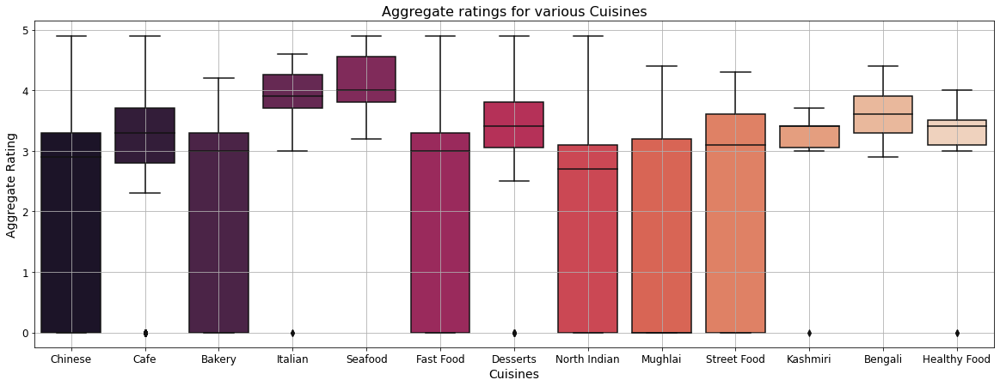

In [16]:
# Create a 20x7 inch figure
fig, ax = plt.subplots(figsize=(20,7))

# Most common agg. rating for each type of cuisine
cuisines_list = sorted(['North Indian', 'Chinese', 'Fast Food', 'Mughlai', 'Cafe', 'Bakery', 'Desserts', 'Street Food', 'Seafood', 'Kashmiri', 'Bengali', 'Healthy Food', 'Italian'])
cuisines = df.loc[df['Cuisines'].isin(cuisines_list)]
cuisines_data = cuisines[['Average Cost for two', 'Price range', 'Aggregate rating', 'Cuisines']]
sns.boxplot(x='Cuisines', y='Aggregate rating', data=cuisines_data, palette='rocket')

# Adding Cosmetics
plt.title('Aggregate ratings for various Cuisines', fontsize=16)
plt.xlabel(xlabel='Cuisines', fontsize=14)
plt.ylabel(ylabel='Aggregate Rating', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(b=True)
plt.show()

**Observations**:

- **Chinese**, **Bakery**, **Fast Food**, and **North Indian** Cuisines have ratings ranging from **0 to 4.9** with **median rating** around **3.0**.

- **Mughlai** and **Street Food** Cuisines have ratings ranging from **0 to 4.5** with **median rating** above **3.0**.

- **Kashmiri**, **Bengali**, **Healthy Food**, **Italian**, and **Seafood** Cuisines have aggregate **ratings** consistently **above 3.0**.

- **Cafe**, **Desserts**, **Kashmiri**, **Italian**, and **Healthy Food** have some **low ratings** present which act as **outliers** from their usual ratings.






**<h4>Question:** What is the distribution of number of votes in the dataset?</h4>

In [17]:
# Create a histogram for Votes feature
fig = go.Figure(data=[go.Histogram(x=df['Votes'])])

# Update the layout with some cosmetics
fig.update_layout(height=600, 
                  width=1200, 
                  title_text='Number of Votes', 
                  title_x=0.5
                  )

fig.update_traces(marker_color='red',
                  opacity=0.6)

# Display the figure
fig.show()

**Observations**:

- The Votes feature is highly skewed and we can't extract much information unless we filter out some data.

- We have **2747 restaurants** with number of votes between **0-9**.

- Furthermore, there are overall **8340 restaurants** with **less than 500 votes**.

- Let's filter out data and check **distribution of votes** for restaurants receiving **more than 500 votes**:

In [18]:
# Create a histogram for Votes feature woth more than 500 votes
fig = go.Figure(data=[go.Histogram(x=df[df['Votes']>500]['Votes'])])

# Update the layout with some cosmetics
fig.update_layout(height=600, 
                  width=1200, 
                  title_text='Number of Votes', 
                  title_x=0.5
                  )

fig.update_traces(marker_color='blue',
                  opacity=0.6)

# Display the figure
fig.show()

**Observations**:

- There are **9 restaurants** which has received votes between **5,000-6,000**, **1 restaurant** receiving votes between **6,000-7,000** votes.

- Also, we have **2 restaurants** receiving votes between **7,000-8,000** votes and a restaurant named **Truffles** receiving **9,667 votes**.

- Finally, we have one restaurant - **Toit**, receiving the highest amount of votes - **10,934 votes**.

**<h4>Question:** What are top 10 Restaurants with highest number of votes in the dataset?</h4>

In [19]:
# Top 10 Restaurants with highest no. of votes

max_votes = df['Votes'].sort_values(ascending=False).head(11)
restos = df.loc[df['Votes'].isin(max_votes)][['Restaurant Name','Votes', 'City']].reset_index()

# Barplot for top 10 restaurants
fig = px.bar(restos, x=restos['Restaurant Name'],
             y=restos['Votes'],
             hover_data=['Restaurant Name', 'City', 'Votes'],
             color=restos['Restaurant Name'],
             title='Top 10 Highest Voted Restaurants')

fig.update_layout(bargap=0.1)
fig.show()

**Observations**:

- We have Toit with the highest amount of votes at 10,934 votes, followed by Truffles at 9,667.

- Now, we have Absolute Barbecues' 2 branch with a lot of votes, the Bangalore branch receiving 6,907 votes and the Hyderabad branch receiving 5,434 votes.

- If we **combine** these branches' votes, we get a **total of 12,341 votes** for **Absolute Barbecues**.

- **All the restaurants** in this list have **more than 5,000 votes!**

## **Analysis on India**

- We had a good look at the overall data and it is dominated by **India!** So let's give India a proper analysis.

In [20]:
india = df[df['Country']=='India']
india.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Country
615,3400025,Jahanpanah,1,Agra,"E 23, Shopping Arcade, Sadar Bazaar, Agra Cantt, Agra",Agra Cantt,"Agra Cantt, Agra",78.011544,27.161661,"North Indian, Mughlai",850,Indian Rupees(Rs.),No,No,No,No,3,3.9,Yellow,Good,140,India
616,3400005,Time2Eat - Mama Chicken,1,Agra,"Main Market, Sadar Bazaar, Agra Cantt, Agra",Agra Cantt,"Agra Cantt, Agra",78.011608,27.160832,North Indian,500,Indian Rupees(Rs.),No,No,No,No,2,3.6,Yellow,Good,94,India
617,3400021,Chokho Jeeman Marwari Jain Bhojanalya,1,Agra,"1/48, Delhi Gate, Station Road, Raja Mandi, Civil Lines, Agra",Civil Lines,"Civil Lines, Agra",77.998092,27.195928,Rajasthani,400,Indian Rupees(Rs.),No,No,No,No,2,4.0,Green,Very Good,87,India
618,3400017,Pinch Of Spice,1,Agra,"23/453, Opposite Sanjay Cinema, Wazipura Road, Sanjay Place, Civil Lines, Agra",Civil Lines,"Civil Lines, Agra",78.007553,27.201725,"North Indian, Chinese, Mughlai",1000,Indian Rupees(Rs.),No,No,No,No,3,4.2,Green,Very Good,177,India
619,3400059,Peshawri - ITC Mughal,1,Agra,"ITC Mughal, Fatehabad Road, Tajganj, Agra","ITC Mughal, Tajganj","ITC Mughal, Tajganj, Agra",78.044095,27.160934,"North Indian, Mughlai",2500,Indian Rupees(Rs.),No,No,No,No,4,4.3,Green,Very Good,133,India


**<h4>Question:** What are popular cuisines in India?</h4>

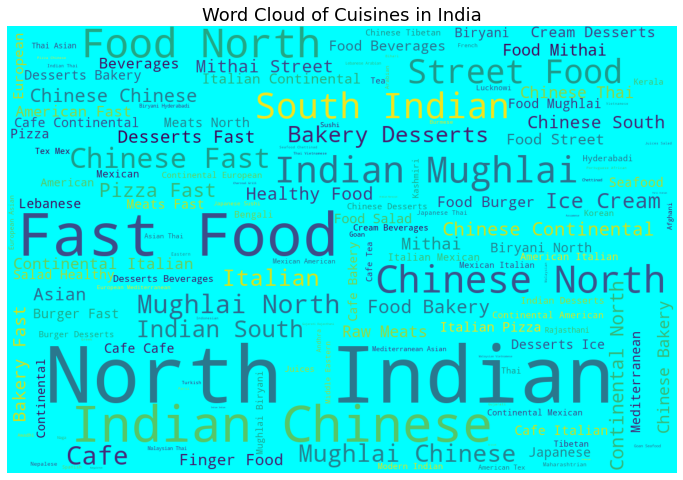

In [21]:
# Create a figure with 12x12 inch dimension
fig = plt.figure(figsize=(12, 12))
stopwords = set(list(STOPWORDS))
wordcloud = WordCloud(background_color = 'cyan', stopwords = stopwords, width = 1200, height = 800).generate(str(india['Cuisines']))

plt.title('Word Cloud of Cuisines in India', fontsize = 18)
plt.axis('off')
plt.imshow(wordcloud);

**Observations**:

- We can see **North Indian, Chinese, Indian, Fast Food, South Indian, Mughlai, Mithai, Street Food, Bakery, Deserts**, and **Italian** dominating the Indian Cuisines.

**<h4>Question:** What are popular food chains in India?</h4>

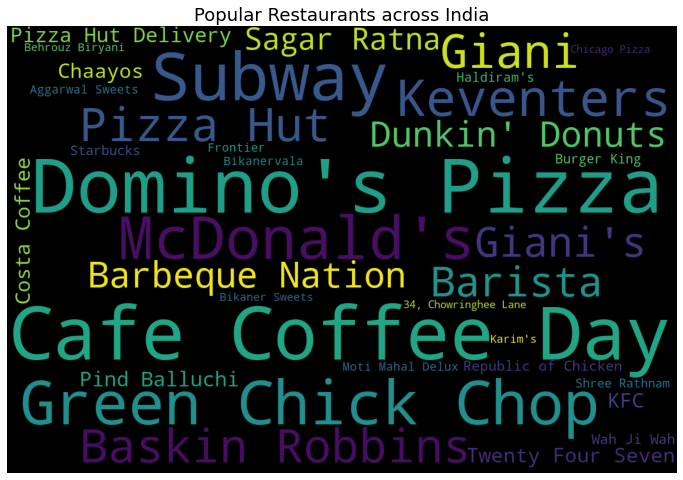

In [22]:
# Create a figure with 12x12 inch dimension
fig = plt.figure(figsize=(12, 12))
stopwords = set(list(STOPWORDS))
wordcloud = WordCloud(background_color = 'black', stopwords = stopwords, width = 1200, height = 800).generate_from_frequencies(india['Restaurant Name'].value_counts().head(35))

plt.title('Popular Restaurants across India', fontsize = 18)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

**Observations**:

- **Cafe Coffee Day**, **McDonald's**, and **Domino's Pizza** have the most number of food chians all over the country.

- We can also see **Subway**, **Baskin Robbins**, **Keventers**, **Pizza Hut**, **Barbeque Nation**, **Green Chick Chop** as well as **Haldiram's** with a lot of branches.

**<h4>Question:** What is the relation between price (price range and average cost for two) and aggregate rating in Indian restaurants?</h4>

In [23]:
fig=px.scatter(india,
               x="Average Cost for two", 
               y="Aggregate rating", 
               color="Price range",
               hover_data=["Restaurant Name", 'Average Cost for two', "Aggregate rating", "Price range"])

fig.update_traces(marker=dict(size=8,
                              line=dict(width=1,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.show()

**Observations**:

- We don't observe any particular relationship between the two features.

- But we can see that some restaurants with **Average price** as low as **150** (Naturals Ice Cream) have received an **aggregate rating of 4.9**.

- There are some places where **Average price for 2** is **not available** (Sheroes Hangout or UrbanCrave) and yet they have some **good ratings**

- At the expensive side of spectrum, the **aggregate rating** is consistently **above 3**.

- We can go ahead and include the **city-wise distribution** of restaurants with **price**, **name**, and **rating text**:

In [24]:
df1 = px.data.gapminder()

fig = px.scatter(india, 
                 x="Average Cost for two", 
                 y="Aggregate rating", 
                 animation_frame="City", 
                 animation_group="Restaurant Name",
                 color="Rating text", 
                 hover_data=["City" ,"Restaurant Name"],
                 log_x=True, 
                 size_max=80, 
                 range_y=[0,5])

fig.show()

**<h4>Question:** Which are the top expensive restaurants in India?</h4>

In [25]:
fig = px.scatter_mapbox(india.nlargest(500, 'Average Cost for two'), 
                        lat="Latitude", 
                        lon="Longitude",
                        hover_name="City", hover_data=["Aggregate rating","Restaurant Name","Average Cost for two", "Has Table booking"],
                        color_discrete_sequence=["fuchsia"],
                        zoom=3, 
                        height=300,
                        color='Aggregate rating',
                        size='Average Cost for two')


fig.update_layout(margin=dict(l=20, r=20, t=30, b=20),
                  mapbox_style="open-street-map",
                  title='500 Most Expensive Resturant Locations in India',
                  showlegend=False,
                  width=800,
                  autosize=True,
                  height=500)

fig.show()

**Observations**:

- Most of the restaurants are based in **New Delhi** and **surrounding areas**.

- Though, we can see some patches from **Pune**, **Bangalore**, **Chennai**, **Mysore**, **Goa**, and **Kolkata**.

- Most of the places **outside New Delhi** have aggregate rating of **above 3.0**.

## **Analysis of Restaurants in New Delhi**

In [26]:
delhi = df[(df['City']=='New Delhi') | (df['City']=='Delhi')]
delhi.shape

(5240, 22)

**<h4>Question:** Which are the most expensive restaurants in New Delhi?</h4>

In [27]:
delhi.nlargest(100, 'Average Cost for two')[['Restaurant Name', 'Locality', 'Average Cost for two', 'Aggregate rating']]

,Restaurant Name,Locality,Average Cost for two,Aggregate rating
7191,Orient Express - Taj Palace Hotel,"The Taj Palace Hotel, Chanakyapuri",8000,4.0
3876,Tian - Asian Cuisine Studio - ITC Maurya,"ITC Maurya, Chanakyapuri",7000,4.1
3875,Bukhara - ITC Maurya,"ITC Maurya, Chanakyapuri",6500,4.4
7140,Nostalgia at 1911 Brasserie - The Imperial,"The Imperial, Janpath",6000,3.2
7142,1911 - The Imperial,"The Imperial, Janpath",6000,3.9
7147,The Spice Route - The Imperial,"The Imperial, Janpath",6000,4.0
7186,Wasabi by Morimoto - The Taj Mahal Hotel,"The Taj Mahal Hotel, Mansingh Road",6000,3.9
7170,MEGU - The Leela Palace,"The Leela Palace, Chanakyapuri",5500,3.9
7187,House of Ming - The Taj Mahal Hotel,"The Taj Mahal Hotel, Mansingh Road",5500,4.0
7160,24/7 Restaurant - The Lalit New Delhi,"The Lalit New Delhi, Barakhamba Road",5100,3.7


In [28]:
fig = px.scatter_mapbox(delhi.nlargest(100, 'Average Cost for two'), 
                        lat="Latitude", 
                        lon="Longitude",
                        hover_name="City", hover_data=["Aggregate rating","Restaurant Name","Average Cost for two", "Has Table booking", 'Locality'],
                        color_discrete_sequence=["fuchsia"],
                        zoom=9.5, 
                        height=300,
                        color='Aggregate rating',
                        size='Average Cost for two')


fig.update_layout(mapbox_style="open-street-map",
                  title='100 Most Expensive Resturant Locations in Delhi',
                  showlegend=False,
                  width=800,
                  autosize=True,
                  height=500)

fig.show()

**Observations**:

- We can observe a lot of restaurants in many localities like **Connaught Place**, **Aerocity**, **Barakhamba Road**, and **Janpath**.

- Some restaurants are unrated as well like **Playboy Club** and **Aqua Grill**.

- Other than these, most of the restaurants have an aggregate rating of more than **3.3**.

## **Analysis of Restaurants in Mumbai**

- **Mumbai**, **Kolkata**, and **Bangalore** each have **20 outlets** of Foodazing. 

In [29]:
mumbai = df[df['City']=='Mumbai']
mumbai.shape

(20, 22)

**<h4>Question**: In which areas in **Mumbai** is Foodazing established? </h4>

In [30]:
fig = px.bar(mumbai, 
             x=mumbai['Locality'],
             color=mumbai['Has Table booking'],
             hover_data=["Aggregate rating","Restaurant Name","Average Cost for two", "Has Table booking"])

fig.update_layout(bargap=0.1,
                  title_text="Localities in Mumbai where Table Bookings are and aren't available",
                  title_x=0.8,
                  title_y=0.8,
                  )

fig.show()

**Observations**:

- We can see **14 different localities** across Mumbai.

- Most of them being in **Lower Parel** and **Malad West**.

- **Tea Villa** is the mostly collaborated with restaurant chain in Mumbai by Foodazing.

## **Presence of Chain outside India**

**<h4>Question**: In which countries **outside India** is Foodazing established? </h4>

In [31]:
rest = df[df['Country']!='India']
print('Foodazing is established in {} countries outside India.'.format(rest['Country'].nunique()))
rest.head()

Foodazing is established in 14 countries outside India.


,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Country
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenue, Poblacion, Makati City","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Makati City",121.027535,14.565443,"French, Japanese, Desserts",1100,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314,Phillipines
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Makati City",121.014101,14.553708,Japanese,1200,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591,Phillipines
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Mandaluyong City",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270,Phillipines
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.056475,14.585318,"Japanese, Sushi",1500,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365,Phillipines
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandaluyong City",121.057508,14.584450,"Japanese, Korean",1500,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229,Phillipines


In [32]:
# Extract labels and values of ratings
labels = rest['Country'].value_counts().index
values = rest['Country'].value_counts().values

# Initiate an empty figure
fig = go.Figure()

# Add a trace of pie to the figure
fig.add_trace(trace=go.Pie(labels=labels, 
                           values=values,
                           hoverinfo='label+percent+value',
                           domain = {"x": [0, .9]},
                           rotation = 120, 
                           hole=.6
                           ))

# Update the layout with some cosmetics
fig.update_layout(height=600, 
                  width=1000, 
                  title_text="Foodazing's Presence outside India",
                  title_x=0.2,
                  title_y=0.9,
                  )

fig.update_traces(textfont_size=12,
                  marker=dict(line=dict(color='#000000', width=2)))

# Display the figure
fig.show()

**Observations**:

- We have the **USA** where the presence is the highest outside India with **425 restaurants**, followed by the **UK** with **80 restaurants**.

- We observe 60 restaurants each in **UAE**, **Brazil**, and **South Africa**.

- Also, we see 20 restaurants each in **Singapore**, **Qatar**, and **Indonesia**.

- **Canada** can see the aggregator established with only **4 restaurants** which is the **lowest** among the 14 countries in the dataset.

**<h4>Question**: Which are the preferred cuisines in countries outside India? </h4>

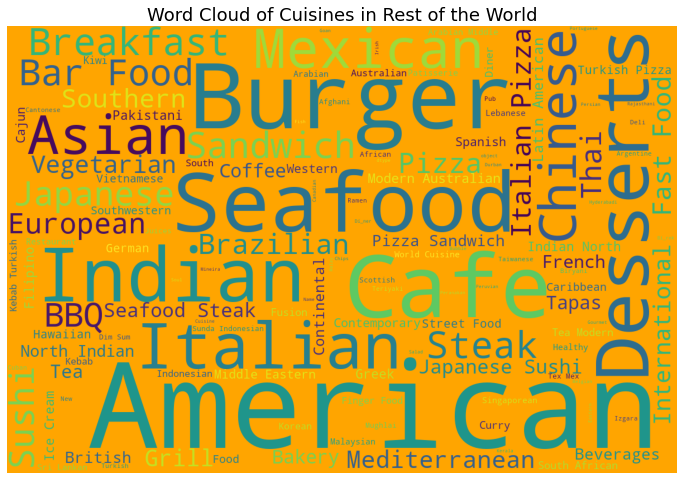

In [33]:
# Create a figure with 12x12 inch dimension
fig = plt.figure(figsize=(12, 12))
stopwords = set(list(STOPWORDS))
wordcloud = WordCloud(background_color = 'orange', stopwords = stopwords, width = 1200, height = 800).generate(str(rest['Cuisines']))

# Adding cosmetics
plt.title('Word Cloud of Cuisines in Rest of the World', fontsize = 18)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

**Observations**:

- **American**, **Burger**, **Seafood**, **Indian**, **Chinese**, **Cafe**, **Italian**, **Mexican**, and **Breakfast** are some of the most preferred cuisines **outside India**.

**<h4>Question**: What is the price distribution of restaurants in countries outside India? </h4>

In [34]:
fig = px.scatter_mapbox(rest.nlargest(500, 'Average Cost for two'), 
                        lat="Latitude", 
                        lon="Longitude",
                        hover_name="Country", 
                        hover_data=["Aggregate rating", "Restaurant Name", "Currency", "Average Cost for two", "Has Table booking"],
                        color_discrete_sequence=["fuchsia"],
                        zoom=1,
                        #animation_frame="Country", 
                        #animation_group="Restaurant Name",
                        color='Average Cost for two',
                        size_max=40)


fig.update_layout(margin=dict(l=20, r=20, t=30, b=20),
                  mapbox_style="open-street-map",
                  title='500 Most Expensive Resturant Locations outside India (Country-wise)',
                  showlegend=False,
                  width=800,
                  height=600)

fig.show()

**Observations**:

- The above plot lets you check the price distribution of various restaurants in various countries.

- A [**Currency Conversion website**](https://www.worlddata.info/currencies/inr-indian-rupee.php) can be used to determine the current price of the places listed to **Indian Rupees**.

---
<a name = Section9></a>
# **9. Summarization**
---




<a name = Section91></a>
### **9.1 Conclusion**

-	Most of the Restaurants are from India (8156), followed by USA.

-	Out of the 9000 restaurants, **more than 1800** are **Not Rated**.

-	Most of the restaurants have Aggregate rating ranging **between 3.0 to 4.0**.

-	There are **144 unique cuisines** across all the restaurants.

-	**8340 restaurants** with less than **500 votes**.

-	**Toit** has the **highest amount of customer votes** - 10,934 votes.

-	**North Indian, Chinese, Indian, Fast Food, South Indian, Mughlai, Mithai, Street Food, Bakery, Deserts**, and **Italian** are the popular cuisines in India

-	**Cafe Coffee Day, McDonald's, Domino's Pizza, Subway, Baskin Robbins, Keventers, Pizza Hut, Barbeque Nation, Green Chick Chop**, and **Haldiram's** have a lot of chains across India.

-	Most of the Indian restaurants are **based in New Delhi** and its surrounding areas.

-	A lot of New Delhi based restaurants are present in many localities like **Connaught Place, Aerocity, Barakhamba Road**, and **Janpath**.

-	**Mumbai, Kolkata**, and **Bangalore** each **have 20 outlets** with Foodazing.

-	Foodazing is established in **14 countries outside India**.

-	**USA** has **highest number** of the restaurants outside India with **425 restaurants**, followed by the **UK with 80 restaurants**.

-	**American, Burger, Seafood, Indian, Chinese, Cafe, Italian, Mexican**, and **Breakfast** are some of the most preferred **cuisines outside India**.


<a name = Section92></a>
### **9.2 Actionable Insights**

- The company has a lot of potential to expand indoors in Mumbai, Pune, Kolkata, Hyderabad, Indore, and Bangalore.

- The company can also expand to other **Arabic** countries as well as other **Asian-Pacific** countries like **South Korea** and **Japan**.

- An establishment in the EU can be given a try with **France**, **Germany**, or **Italy**.

- The company should **track** and find out why **1/5th** of it's collaborating restaurants are **unrated**.

- **Offers** can be combined with a lot food chains like **McDonald's** and **Domino's Pizza**.